# DCGAN 논문리뷰 과제 - 투빅스 10주차 생성모델

이번 과제는 [Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks](https://arxiv.org/abs/1511.06434) 을 리뷰하는 과제입니다.

마크다운을 사용해서 간단하게 정리하였습니다.

# 참고
- DCGAN 논문 이해하기(angrypark) : https://angrypark.github.io/generative%20models/paper%20review/DCGAN-paper-reading/
- 파이토치 DCGAN튜토리얼 : https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
- [논문읽기] 07.DCGAN (차밍) : https://leechamin.tistory.com/222

# Abstract

- CNN을 활용한 지도 학습은 컴퓨터 비전 분야에서 많이 적용되었으나, 비지도 학습 분야에서는 많이 적용되지 못했다.
- 본 논문은 CNN을 활용한 GAN을 제시하는데, 이는 비지도학습에서 큰 성과를 보였다.
- 학습된 features를 다른 분야에도 적용해 범용성을 입증했다.

# Introduction

- 컴퓨터 비전 분야에서, 매우 무제한의 이미지와 비디오는 더 좋은 intermediate representation을 얻을 수 있으며, 이는 지도학습에서 다양한 분야에 사용된다.
- GAN은 이미지 표현을 만드는 데 매우 좋은 방법이며, 생성자와 구별자 네트워크만을 활용하여 feature extractors로 활용할 수 있다.
- GAN은 최대우도법(maximum likelihood)을 대신하여 휴리스틱한 Cost function을 사용한다.
- 하지만 GAN은 학습 안정성이 떨어지며, nonsensical한 결과를 생성한다는 문제가 있었다.

본 논문에서는 이 문제를 해결하기 위해 아래 방법을 사용하였다.
- **GAN에 Convolutional한 층을 적용**해서 대부분의 경우에서 학습안정성을 높일 수 있었다.
- **이미지 분류 문제에 학습된 구분자**를 사용했다. 이는 상당히 경쟁력였는 결과가 나타났다.
- **GAN의 필터를 시각화** 했으며, 특정 필터가 특정 오브젝트를 그리는 것을 확인했다.
- 생성자는 **벡터의 수학적 계산이 가능한 특징이 있었다.** 이는 생성된 샘플의 선형적인 조작이 가능하게 한다.(기쁨 - 슬픔 의 선에서 파라미터를 조정가능하다는 뜻으로 보인다.)

# Related Work

## Representation Learning From Unlabeled Data

- 비지도 표현 학습은 컴퓨터 비전 분야에서 많이 연구되고 있었던 분야이다.
- 전통적인 분야는 K-means등을 활용한 클러스터링이었다.
- 다른 방법으로는 오토인코더를 활용하는 방법, ladder structures를 활용하는 방법 등이 유명했다.
- Deep belief networks는 계층적 표현을 학습하기에 좋은 것으로 나타났다.

## Generating Natural Images
- 생성모델은 parametic한 방법과 non-parametic 한 방법 두가지로 나뉘어 연구되고 있다.
- non-parametic한 모델은 존재하는 이미지와의 매칭을 수행한다.
- parametic 모델은 최근 집중적으로 연구되고 있으나, 최근 크게 성공하지는 못했다.
- VAE를 이용한 모델은 조금 성과가 있었지만, 이미지가 흐릿한 문제가 있었고, GAN은 이미지가 노이즈가 있고, 해석하기 어렵다는 문제가 생긴다. laplacian pyramid extension 접근법 또한 노이즈 문제가 있다. 순환 신경망이나, deconvolution 네트워크 등도 주목할만한 성과를 이끌어 내지 못했다.

## Visualizing the Internals of CNNs
- **신경망의 비판점 중 하나는 블랙박스 방법**이라는 것이다.
- CNN에서는 deconvolution(transposed convolution)과 maximal activation을 활용해 각각의 필터의 대략적인 역할을 시각화했다.
- 비슷하게 경사하강법을 사용해 특정 필터만 활성화시키는 이미지에 대한 인사이트를 얻을 수 있었다.

# Approach and Model Architecture

- CNN을 활용해 GAN을 키우려는 시도는 성공적이지 못했다.
- LAPGAN는 저해상도의 이미지를 반복적으로 업스케일링 해서 이미지를 생성했었다.


본 논문에서는 최근 CNN 구조에서 변화한 요소를 채용해서 업스케일링을 실시했다.
1. spatial Pooling 층을 strided convolution으로 대체했다. 이를 사용해서 생성자는 공간적인 downsampling이 가능하고, 판별자는 upsampling이 가능하다.
2. fully connected layer를 제거하고, Global Average Pooling으로 대체했다.
    - GAP를 사용하면 모델이 더 안정적이지만 수렴 속도가 느려진다.
    - 생성자와 판별자 사이를 직접적으로 연결하는 구조가 도움이 되었다.
    - 생성자의 첫 층은 균등 분포 노이즈 Z를 input으로 넣는다.
    - 이를 4차원의 텐서로 변환하여 Conv 레이어에 넣는다.
    - 판별자는 마지막 층을 flatten 한 뒤에 sigmoid를 사용해 결과를 낸다.
3. Batch Normalization은 학습을 안정화시키는 결과를 내었다.
    - poor initialization 문제나 기울기 소실 등의 문제를 해결했다.
    - 이로서 생성자가 하나의 점으로 모든 input을 붕괴시키는것을 막았다.
    - 모든 점에 Batch Norm을 적용하는 것은 문제가 있어서 생성자의 output과 판별자의 input에는 적용하지 않았다.
4. ReLU 활성화 함수가 생성자에 적용되었다.(마지막 층만 tanh를 사용했다.) 판별자에는 leack ReLU가 적용되었다.

최종적인 모델 구조는 아래 이미지와 비슷하다.(생성자 이미지이다.)

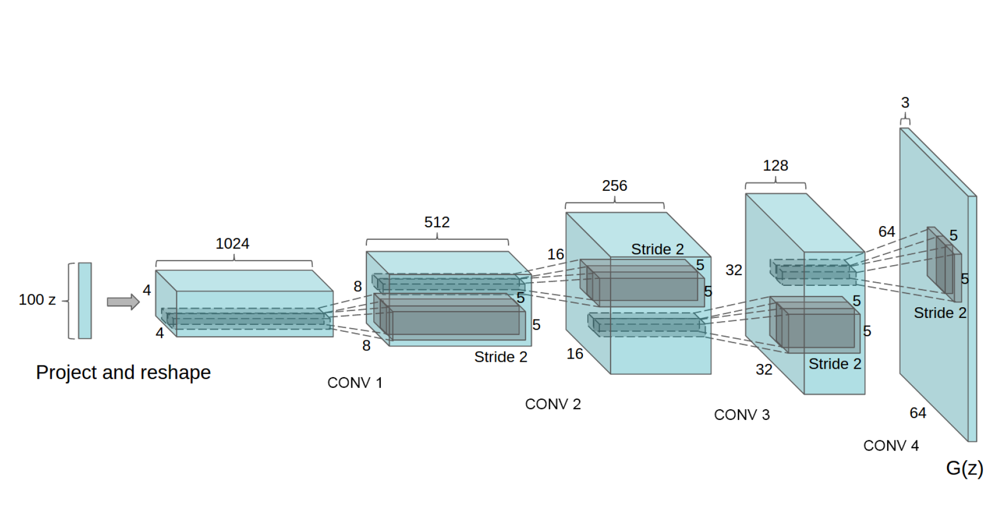


1번 과정에 대해서 조금 더 설명하면, 본 논문은 transposed convolution을 사용하는 것 같다.

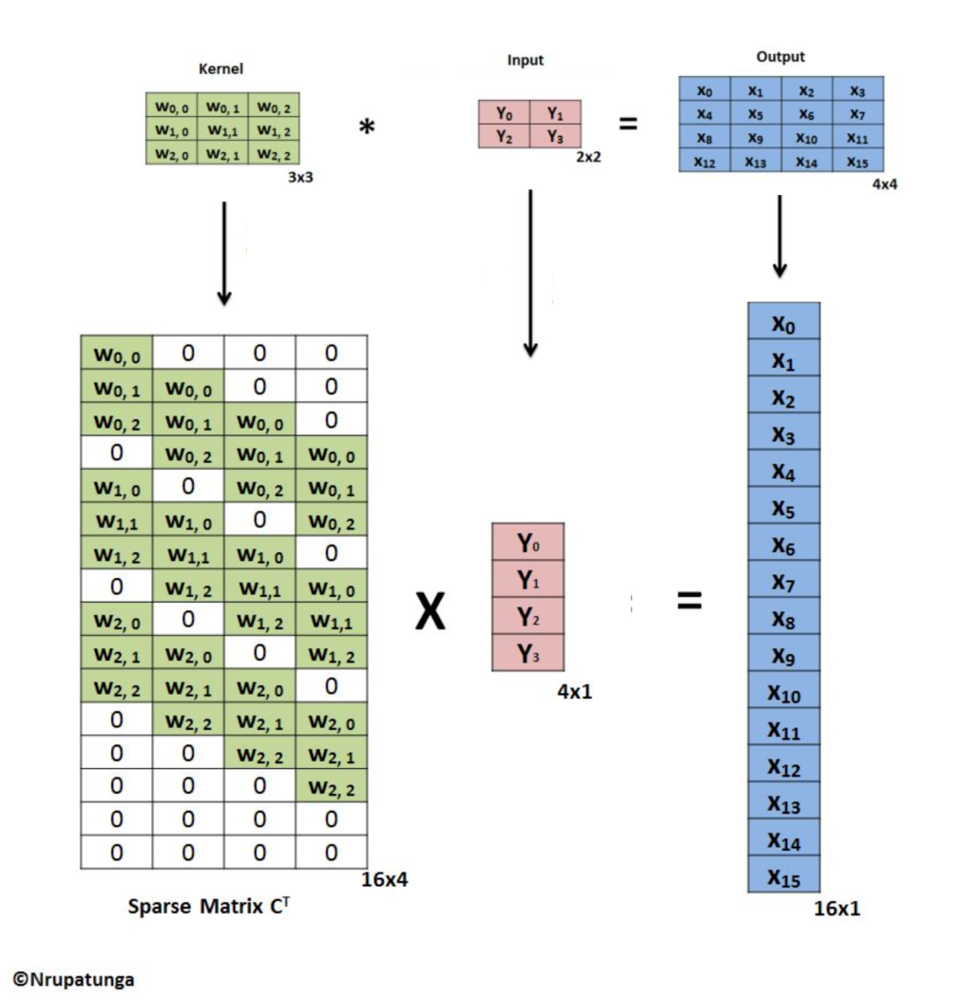

다음 그림과 같이 표현되는데, 이를 조금 명확하게 시각화하면 다음 그림과 같이 나타난다.

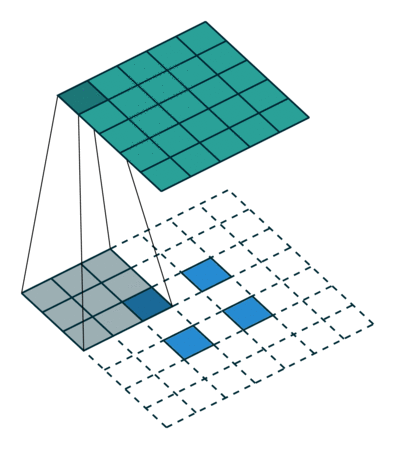

이미지 출처 : https://eehoeskrap.tistory.com/431

이미지 간 픽셀 간격을 조금 유지하면서 합성곱을 수행하고, 이미지를 업샘플링한다.

논문에서는 이를 다양한 방법으로 설명하는데 Deconvolution이라고 표현할 때도 있고(잘못된 표기라고도 말한다), fractionally strided convolution 이라고도 할 때가 있다.


# Details of Adversarial Training

- 본 논문에서는 DCGAN을 3개의 데이터셋으로 트레이닝 했다. (LSUN, Imagenet-1k, 자체 제작된 얼굴 데이터)
- 이미지는 tanh 활성화함수 (-1,1)을 적용하는 것을 빼면 어떠한 전처리도 하지 않았다.
- 모든 모델은 SGD 방식에 배치 사이즈 128로 학습되었다.
- 모든 가중치는 정규분포(0, 0.02)로 초기화 되었다.
- LeakyReLU의 기울기는 0.2로 설정되었다.
- Optimizer로 Adam을 사용했으며, 학습률은 0.0002를 사용했으며, 베타1은 0.5로 지정했다.

## LSUN

- 생성된 샘플의 질이 높아질수록 오버피팅의 위험이나 트레이닝 데이터를 기억하는 문제가 생긴다.
- DCGAN이 이 문제를 해결할 수 있음을 보여주기 위해 LSUN 데이터를 사용했다. 이는 3만개의 침실 이미지가 존재한다.

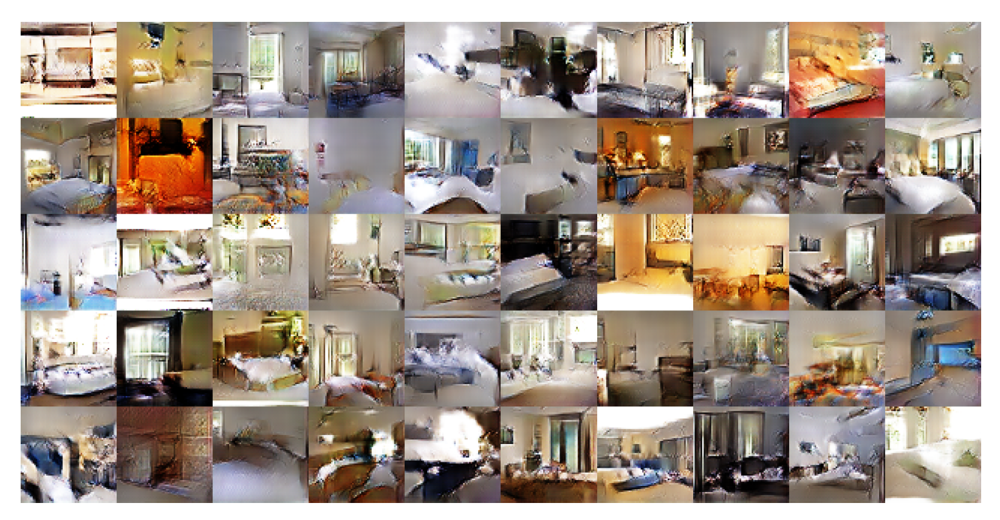

1에폭 트레이닝 한 사진이며, SGD를 사용했기 때문에 학습 데이터를 기억하지 않는다고 생각했다.

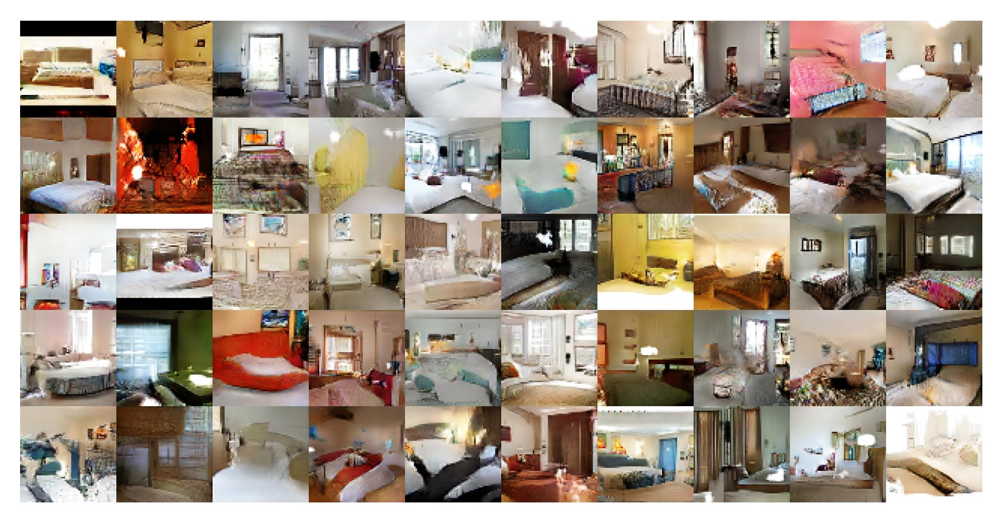

5에폭 트레이닝 한 사진이며, 약간의 노이즈가 있는 것으로 볼 때 언더피팅 된 것이라고 생각된다.

언더피팅 되었다는 뜻은 모델이 단순히 학습 데이터를 기억해서 복제하지 않는다는 사실을 의미한다.(오버피팅 되지 않았다.)

## Faces

- 무작위 인터넷 검색을 통해 데이터 정보를 수집했다.
- dppedia에서 수집한 사람들의 이름을 검색어로 사용하여 무작위 사람들의 사진을 모았다.
- 총 3M개의 이미지와 10K명의 사람들의 데이터이다.
- OpenCV로 얼굴을 찾아 face box로 만들었다.

## Imagenet-1K

- 이미지를 32 * 32 사이즈로 center crop했다.

# Empirical Validation of DCGANs Capabilities

## Classifying CIFAR-10 Using GANs AS a Feature Extractor

- 비지도 학습의 학습성과를 체크하는 방법 중 하나는 지도 학습 데이터의 특징 추출기(feature extractor)로 적용해 보고, 성능을 평가해 보는 것이다.
- Imanenet-1k데이터셋으로 학습된 판별자의 convolutional 필터를 flatten하여 L2-SVM 분류기에 적용해 보았다.
- 그 결과 CIFAR-10데이터(이 데이터를 사용해서는 학습이 수행되지 않았다.) 의 82.8%의 정확도가 나타났다.
- 어떠한 fine-tuning 을 실시하지 않았으며, 수행할 시 더 좋은 성능이 나타날 것으로 기대된다.

구체적인 성과는 다음과 같다.

![image](https://t1.daumcdn.net/cfile/tistory/99C986475D0249E31D)

## Classifying SVHN Digits Using GANs As a Feature Extractor

- StreetViewHouseNumbers(SVHM) 데이터셋을 DCGAN의 판독기를 사용하여 분류해 보았다.
- 전반적인 구조는 CIFAR-10의 구조와 동일하다.
- State-of-the-Art인 22.48%의 오차율을 얻었다.
- 동일한 구조의 CNN 모델로 지도학습 한 결과 28.87%의 정확도를 얻었다.
    - 이는 CNN이 이 정확도에 중요한 요소가 되지 않은 것을 의미한다.(GAN + CNN일때의 시너지 발생)
    
구체적인 성과는 다음과 같다.

![이미지](https://t1.daumcdn.net/cfile/tistory/99AF01485D0249E328)


# Investigating And Visualizing The Internals of The Networks

생성자와 판별자를 다양한 방법으로 연구해 보았다.

Nearest Neighbor Search 나, 최대우도법은 사용하지 않았다. (성능이 좋지 않기 때문이다)

## Walking In The Latent Space

- 처음으로 해본 것은 잠재 공간을 이해해보는 것이었다.
- 잠재공간을 파악할 수 있으면 생성된 이미지에서 물체를 추가하거나 삭제하는 등의 처리가 가능해 질 것이다.


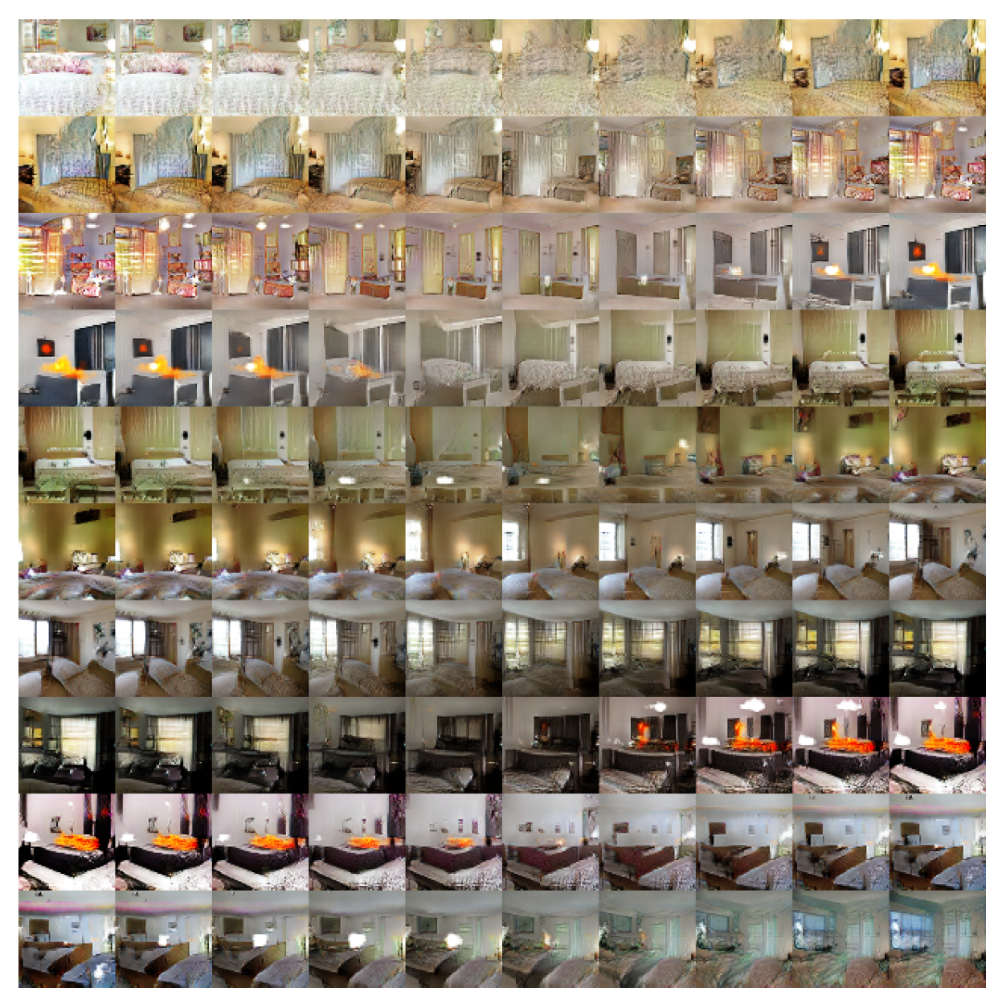

서로 다른 두 개의 이미지를 생성하는 Z의 비중을 조절하여 smooth transitions를 만들어 보았다.

6번째 줄에서 창문이 없는 방이 큰 창문이 있는 방으로 변하거나, 10번째 줄에서 티비가 창문으로 변화하는 등 모습을 보였다.

이미지에 갑작스러운 변화가 생겼을 경우에는 학습 데이터를 기억했다고 볼 수 있으나, 그렇지 않았다.

## Visualizing The Discriminator Features

- CNN의 지도학습을 사용한 기존 연구에서 확인해 볼 때, 이미지에서 특징을 잘 추출해 내는 것을 볼 수 있었다.
- DCGAN 또한 이미지의 계층적인 특징을 잘 추출할 수 있었다.


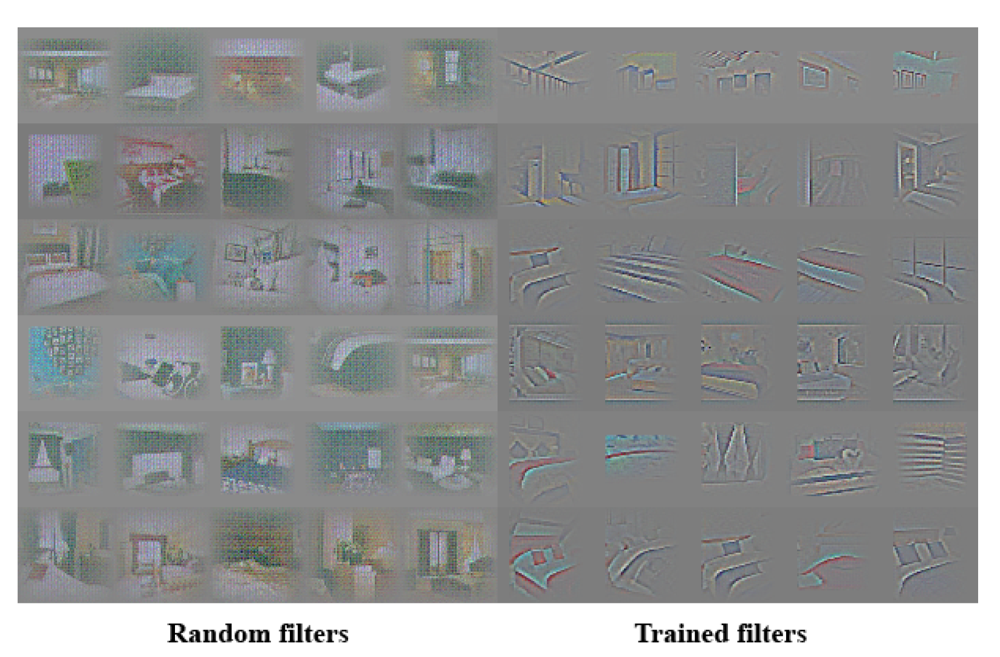

비교를 위해 무작위로 초기화된 가중치의 역전파 가중치를 시각화해 보았는데, 특정한 구조에 대해 설명할 수 없는 것을 볼 수 있다.

반면 오른쪽 이미지는 침대나 나무등의 물체에 대해서 잘 주목하는 것을 확인할 수 있다.

## Manipulating The Generator Representation

### Forgetting To Draw Certain Objects

- 판별자가 침대, 창문, 램프 등과 같은 요소들을 잘 학습하면 샘플의 퀄리티가 높아진다는 것에서 착안해, 샘플에서 특정 요소를 제거하는 작업을 수행했다.
- Conv층 사이에 로지스틱 회귀를 적용해 필터 activation이 일어났는지 안일어났는지를 파악하는 방법을 사용했다.

![이미지](https://t1.daumcdn.net/cfile/tistory/99959C405D0249E322)

이미지를 확인해 보면 약간의 노이즈가 있지만 성공적으로 다른 물체로 대체되는 것을 확인할 수 있었다.

### Vector Arithmetic On Face Samples

- 자연어 분야에서 Vector("King") - Vector("Man") + Vector("Woman") = Vector("Queen")이 나오는 예시가 매우 유명하다.
- 본 논문은 Z 표현에서 같은 결과가 나타나는지 확인했다.
- 3개의 예시에서 일관되고 안정적인 결과가 나오는 것을 확인했다.

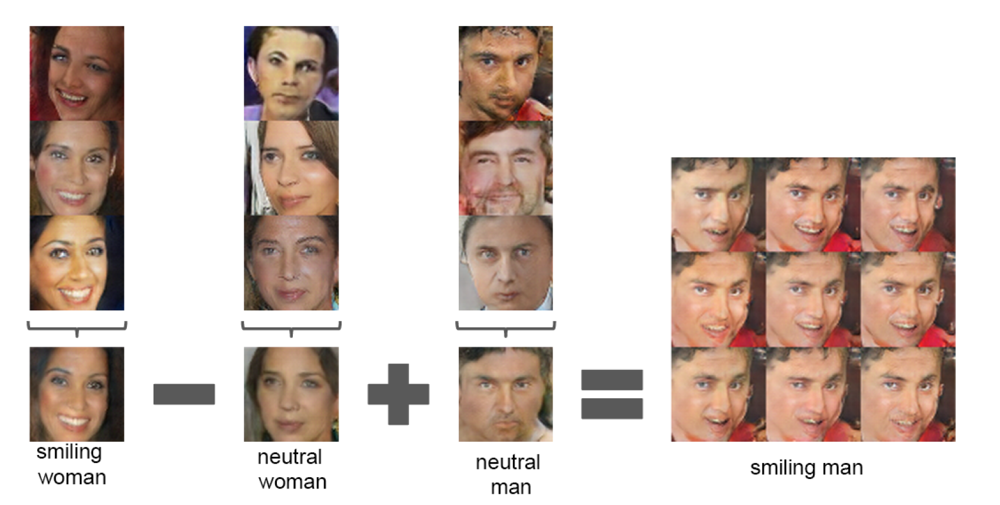
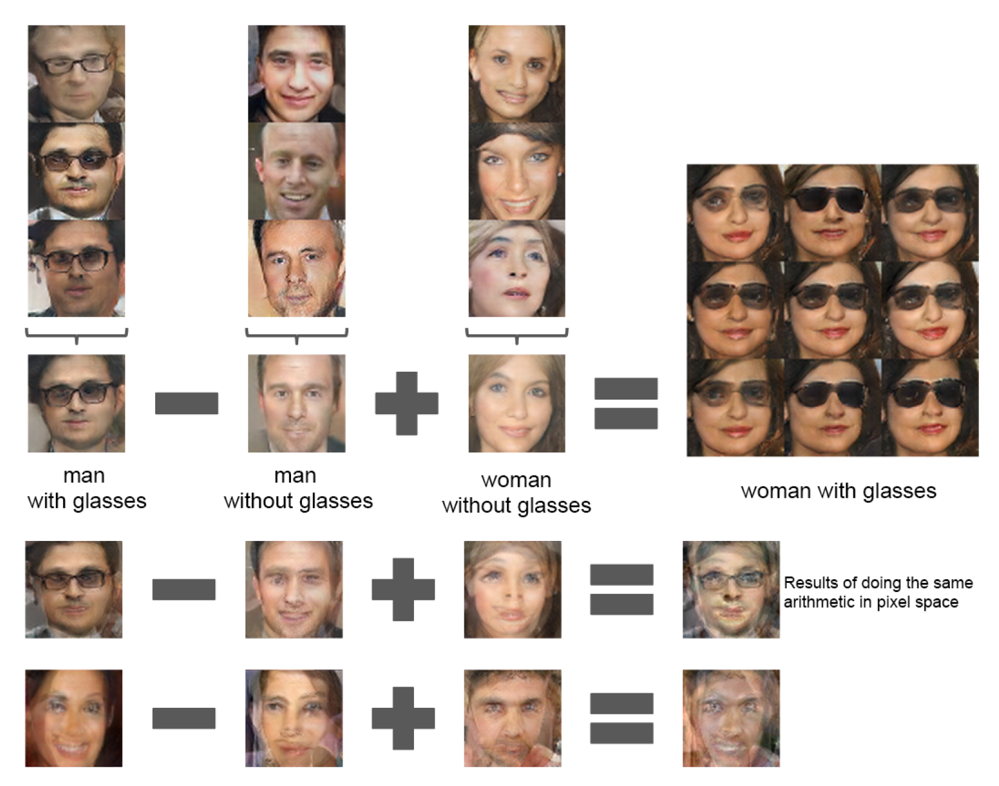

이에 더해 수식의 비율을 조정하면 해당 요소들이 선형적으로 변화하는 모습도 같이 확인할 수 있었다.
 
![image](https://t1.daumcdn.net/cfile/tistory/99897B3E5D0249E325)

이미지를 확인해 볼때 '방향'에 관련된 벡터가 

- 이 결과는 모델이 Z에서 조건(크기, 방향 등)을 이해하고 이미지를 생성할 수 있는 것으로 나타났다.
- 또한 이를 사용하면 학습 데이터의 양을 매우 줄일 수 있을 것으로 생각된다.

# Conclusuion And Future Work

- 본 논문은 더 안정적인 GAN을 제공했으며 generative Modeling 과 지도학습 분야에 있어서 좋은 이미지 표현 방법을 보여 주었다.
- 하지만 본 모델은 오래 학습될수록 single oscillating mode나 collapse(생성자가 판별자를 무조건 속일 수 있는 이미지에만 집착하는 현상)가 발생할 수 있다는 문제점이 있다.
- 더 많은 연구가 이런 불안정성을 해결하기 위해 수행되어져야 할 것으로 보인다.
